# Explore Brains During the Menstrual Cycle

This notebook loads and visualizes the brain data available in the folder `/home/data/28andme`

## Set-up

In [1]:
import setcwd

setcwd.main()

Working directory:  /home/nmiolane/code/my28brains/my28brains
Directory added to path:  /home/nmiolane/code/my28brains
Directory added to path:  /home/nmiolane/code/my28brains/my28brains
Directory added to path:  /home/nmiolane/code/my28brains/H2_SurfaceMatch


## Imports

In [33]:
import os

import matplotlib as mpl
import matplotlib.pyplot as plt
import nibabel
import numpy as np
from IPython.display import HTML
from nilearn import plotting
from PIL import Image, ImageDraw, ImageFont

import my28brains.viz as viz

## Visualize Brain Images from Anatomical T1w

In [4]:
img = nibabel.load("/home/data/28andme/sub-01/ses-02/anat/sub-01_ses-02_T1w.nii.gz")
print(img.header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b'Pritschet^5788rp_1'
extents         : 16384
session_error   : 0
regular         : b'r'
dim_info        : 155
dim             : [  3 208 320 320   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [-1.          0.79999995  0.796875    0.796875    2.5         0.
  0.          0.        ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 1276
glmin           : 0
descrip         : b'phase=-y;TE=2.31;time=20180710120326.365;'
aux_file        : b';SIEMENS;t1_mprage_0.8mm'
qform_code      : scanner
sform_code      : scanner
quatern_b       : -0.02094242


(208, 320, 320)


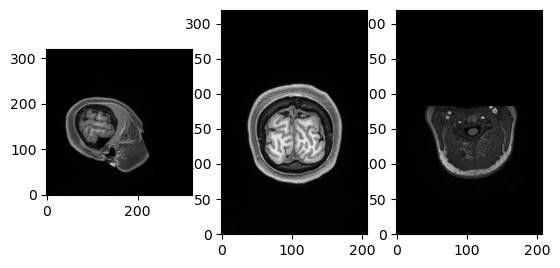

In [5]:
img_data = img.get_fdata()
print(img_data.shape)

slice_0 = img_data[26, :, :]
slice_1 = img_data[:, 30, :]
slice_2 = img_data[:, :, 16]
_ = viz.show_slices([slice_0, slice_1, slice_2])


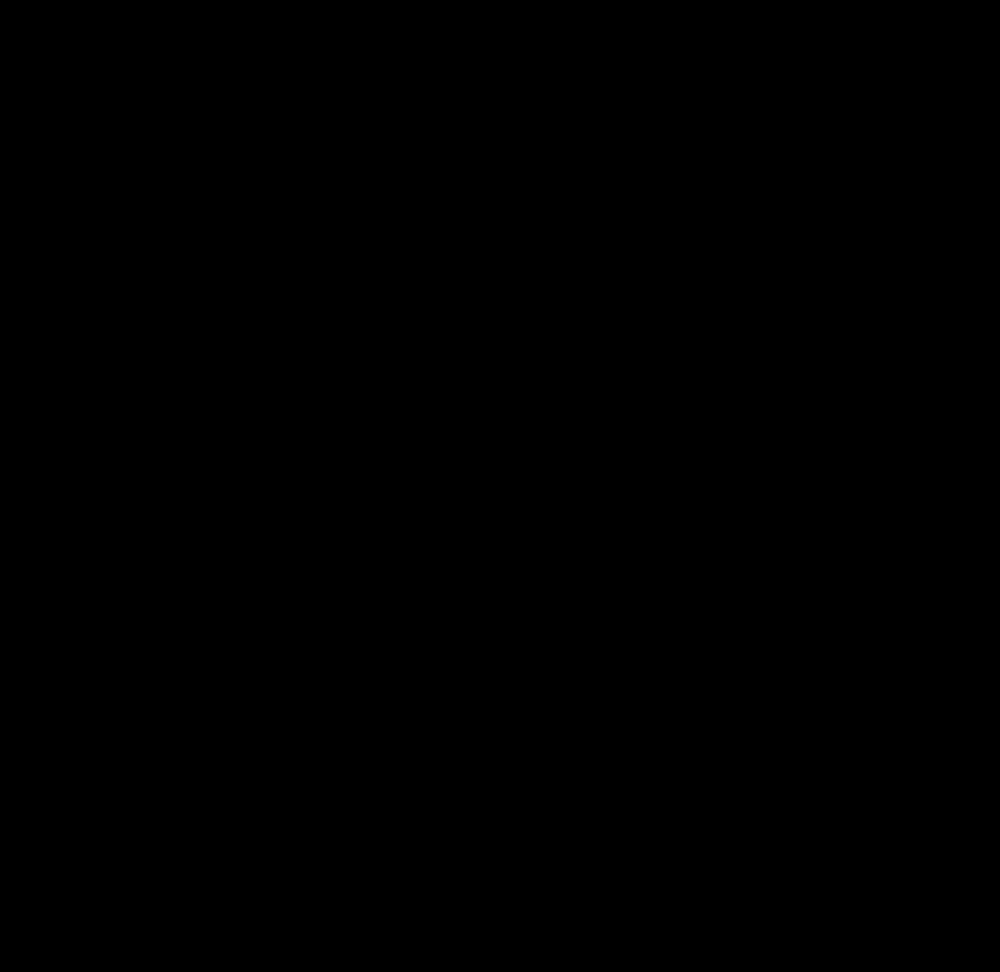
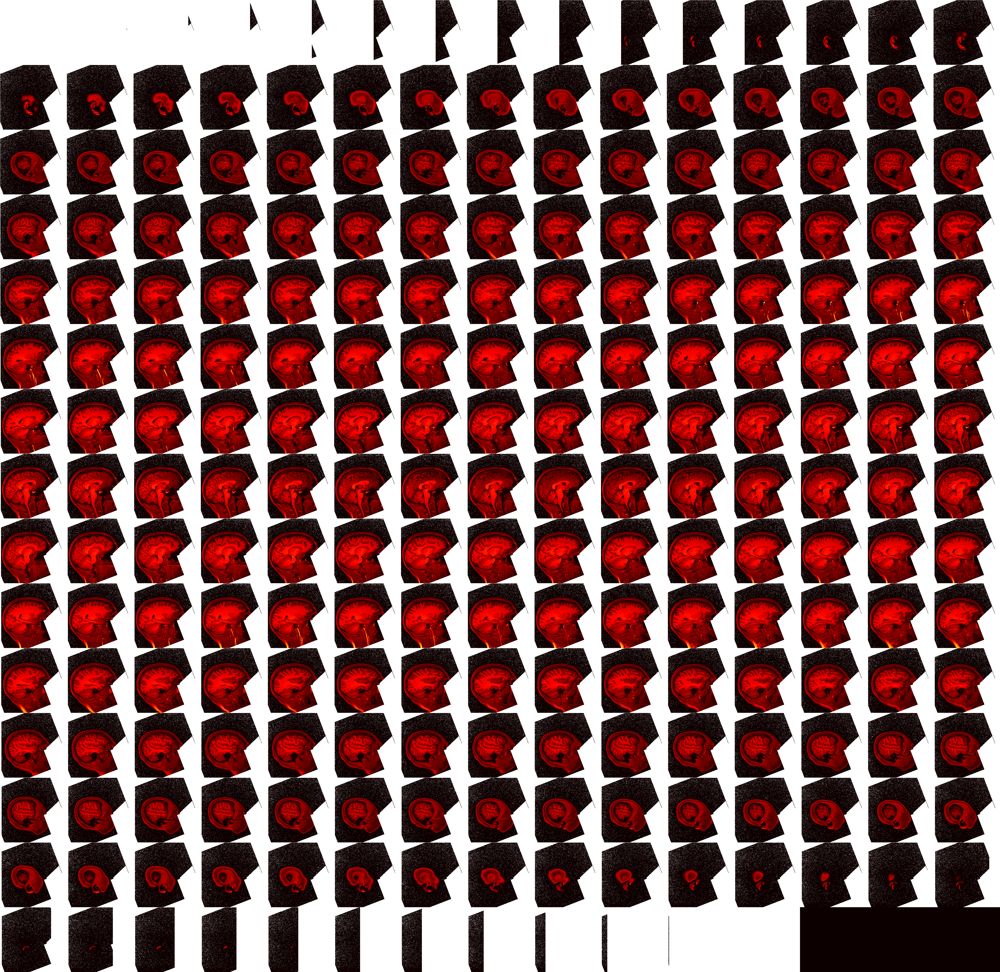

In [6]:
view = plotting.view_img(img, bg_img=False)
view

## Visualize Brain Images from Anatomical T2hipp

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b'Pritschet^5788rp_2'
extents         : 16384
session_error   : 0
regular         : b'r'
dim_info        : 182
dim             : [  3 448 448  31   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [-1.        0.390625  0.390625  2.        8.1       0.        0.
  0.      ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 3266
glmin           : 0
descrip         : b'phase=-x;dwell=271;dTE=48;time=20180710132345.957;'
aux_file        : b';SIEMENS;t2_tse_tra_hi-r'
qform_code      : scanner
sform_code      : scanner
quatern_b       : 0.5656417
quatern

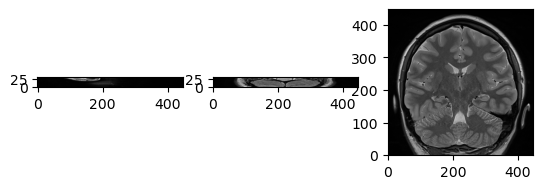

In [7]:
img = nibabel.load("/home/data/28andme/sub-01/ses-02/anat/sub-01_ses-02_T2hipp.nii.gz")
print(img.header)
img_data = img.get_fdata()
print(img_data.shape)

slice_0 = img_data[26, :, :]
slice_1 = img_data[:, 30, :]
slice_2 = img_data[:, :, 16]
_ = viz.show_slices([slice_0, slice_1, slice_2])


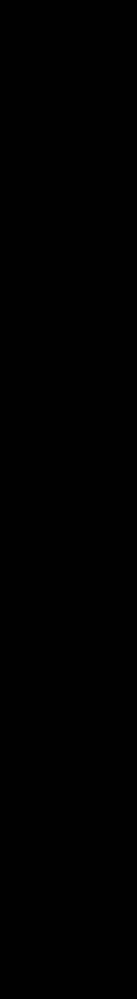
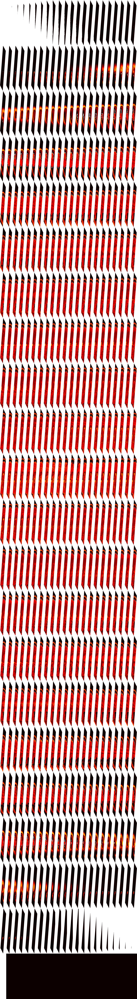

In [8]:
view = plotting.view_img(img, bg_img=False)
view

## Visualize Images from the Segmentation ASHS left_lfseg_corr

10
(448, 448, 31)


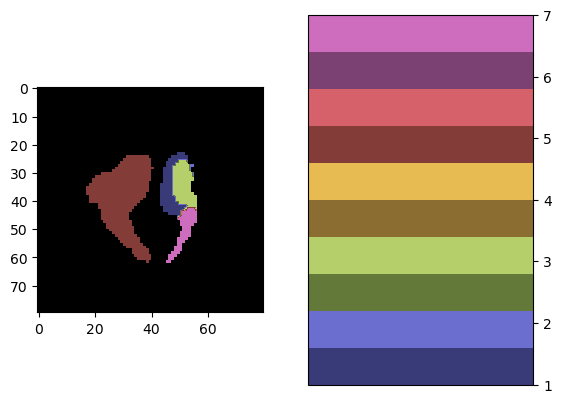

In [9]:
img = nibabel.load(
    "/home/data/28andme/sub-01/ses-02/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz"
)
img_data = img.get_fdata()
print(len(np.unique(img_data.flatten())))
# Set value 0 to "bad data"
img_data = np.ma.masked_where(img_data < 0.05, img_data)
print(img_data.shape)

cmap = mpl.cm.get_cmap("tab20b").copy()
cmaplist = [cmap(2 * i) for i in range(10)]
cmap = mpl.colors.LinearSegmentedColormap.from_list("Custom cmap", cmaplist, 10)
cmap.set_bad(color="black")

fig, axes = plt.subplots(nrows=1, ncols=2)
im = axes[0].imshow(img_data[120:200, 120:200, 16], cmap=cmap)
fig.colorbar(im, cax=axes[-1]);

### Inspect Segmentation: 9 classes

(array([ 2177.,   529.,  2480.,  1736.,     0., 10457.,  3816.,  1458.,
         1671.,  1108.]),
 array([1. , 1.8, 2.6, 3.4, 4.2, 5. , 5.8, 6.6, 7.4, 8.2, 9. ]),
 <BarContainer object of 10 artists>)

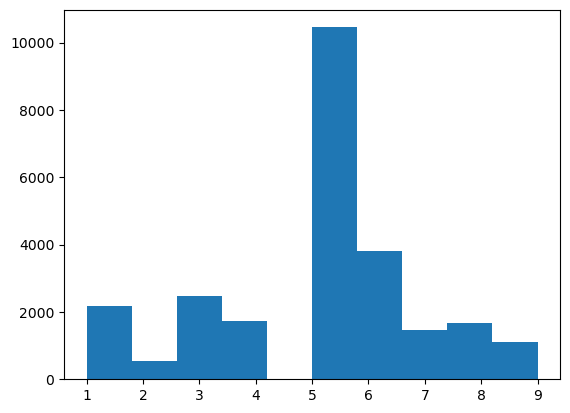

In [10]:
img_vec = img_data.flatten()
img_mask = img_vec[img_vec != 0.0]
plt.hist(img_mask)


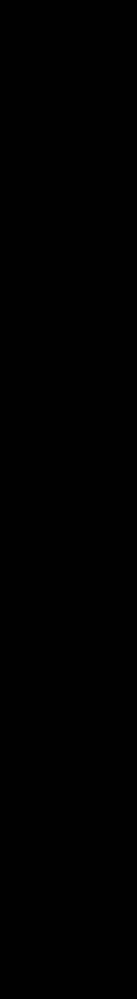
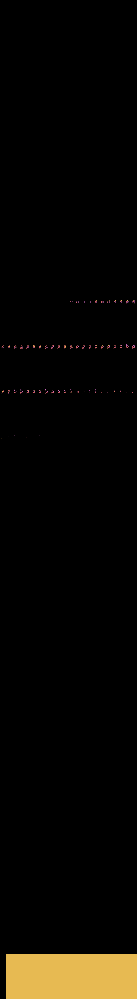

In [11]:
view = plotting.view_img(img, bg_img=False, cmap=cmap)
view

## Visualize Images from the Segmentation ASHS right_lfseg_corr

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 448 448  31   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : uint16
bitpix          : 16
slice_start     : 0
pixdim          : [-1.        0.390625  0.390625  2.        0.        0.        0.
  0.      ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 2
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b''
aux_file        : b''
qform_code      : scanner
sform_code      : unknown
quatern_b       : 0.5656417
quatern_c       : 0.014454967
quatern_d       : 0.02106383
qoffset_x       : -85.21556
qoffset_y       : -55

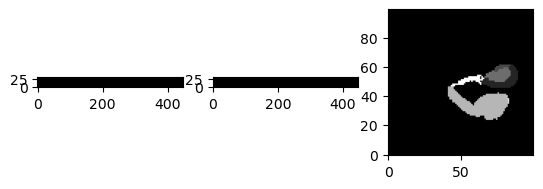

In [12]:
img = nibabel.load(
    "/home/data/28andme/sub-01/ses-02/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz"
)
img_data = img.get_fdata()
print(img.header)
print(img_data.shape)

slice_0 = img_data[26, :, :]
slice_1 = img_data[:, 30, :]
slice_2 = img_data[220:320, 120:220, 16]
_ = viz.show_slices([slice_0, slice_1, slice_2])


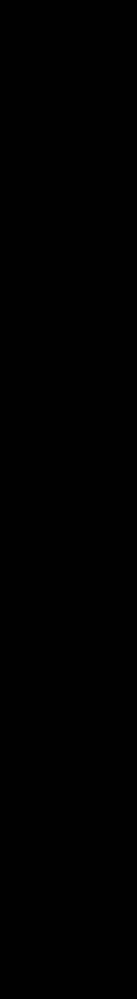
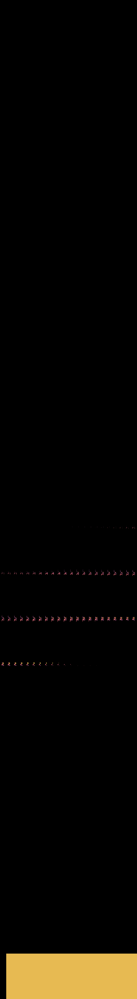

In [13]:
view = plotting.view_img(img, bg_img=False, cmap=cmap)
view

## Play Video of 2D Slice from a Time-Series of 3D Images

Choose which video to play, among:
- anat/sub-01_ses-**_T1w.nii.gz
- anat/sub-01_ses-**_T2hipp.nii.gz
- ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz
- ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz

Found 27 image paths. Creating video.
['/home/data/28andme/sub-01/ses-02/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-03/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-04/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-05/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-06/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-07/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-08/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-09/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-10/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-11/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-12/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-14/ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-0

INFO: Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO: MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -r 20.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmp70lizi0r/temp.m4v


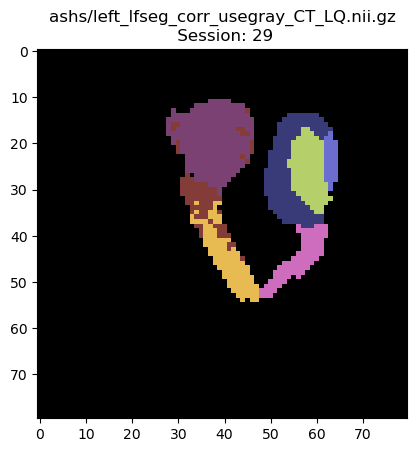

In [14]:
anima = viz.animate("ashs/left_lfseg_corr_usegray_CT_LQ.nii.gz", img_dir="/home/data/28andme/", slice_z=16)
HTML(anima.to_html5_video())

Found 25 image paths. Creating video.
['/home/data/28andme/sub-01/ses-02/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-03/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-04/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-06/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-07/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-08/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-10/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-11/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-12/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-14/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-16/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/28andme/sub-01/ses-17/ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz', '/home/data/2

INFO: Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO: MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 640x480 -pix_fmt rgba -r 20.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmpnlqlwlsd/temp.m4v


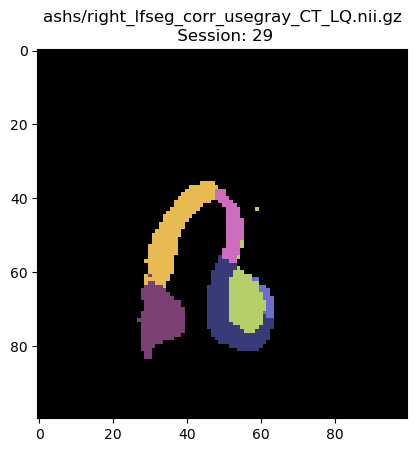

In [15]:
anima = viz.animate("ashs/right_lfseg_corr_usegray_CT_LQ.nii.gz", slice_z=16)
HTML(anima.to_html5_video())

# Make video of Laura's brain for presentation

Creating paths to brain data, one path for each day, contained in nii_paths.

Note that you need to choose which data_dir to use and only use half of the code in the below cell.

In [26]:
# Choose either this data_dir
data_dir = "/home/data/28andme/sub-01"
nii_paths = []
for day in range(2, 31):
    nii_paths.append(f"{data_dir}/ses-{day:02}/anat/sub-01_ses-{day:02}_T1w.nii.gz")
print(nii_paths)

print("\n")
# Or choose this data_dir
# data_dir = "/home/data/28andMeOC_correct"
# hemisphere = "left"
# day_dirs = [os.path.join(data_dir, f"Day{i:02d}") for i in range(1, 61)]

# print(f"Looking into: {day_dirs}")
# nii_paths = []
# for i_day, day_dir in enumerate(day_dirs):
#     for file_name in os.listdir(day_dir):
#         if file_name.startswith(hemisphere) and file_name.endswith(".nii.gz"):
#             nii_paths.append(os.path.join(day_dir, file_name))
#             break
# print(nii_paths)

['/home/data/28andme/sub-01/ses-02/anat/sub-01_ses-02_T1w.nii.gz', '/home/data/28andme/sub-01/ses-03/anat/sub-01_ses-03_T1w.nii.gz', '/home/data/28andme/sub-01/ses-04/anat/sub-01_ses-04_T1w.nii.gz', '/home/data/28andme/sub-01/ses-05/anat/sub-01_ses-05_T1w.nii.gz', '/home/data/28andme/sub-01/ses-06/anat/sub-01_ses-06_T1w.nii.gz', '/home/data/28andme/sub-01/ses-07/anat/sub-01_ses-07_T1w.nii.gz', '/home/data/28andme/sub-01/ses-08/anat/sub-01_ses-08_T1w.nii.gz', '/home/data/28andme/sub-01/ses-09/anat/sub-01_ses-09_T1w.nii.gz', '/home/data/28andme/sub-01/ses-10/anat/sub-01_ses-10_T1w.nii.gz', '/home/data/28andme/sub-01/ses-11/anat/sub-01_ses-11_T1w.nii.gz', '/home/data/28andme/sub-01/ses-12/anat/sub-01_ses-12_T1w.nii.gz', '/home/data/28andme/sub-01/ses-13/anat/sub-01_ses-13_T1w.nii.gz', '/home/data/28andme/sub-01/ses-14/anat/sub-01_ses-14_T1w.nii.gz', '/home/data/28andme/sub-01/ses-15/anat/sub-01_ses-15_T1w.nii.gz', '/home/data/28andme/sub-01/ses-16/anat/sub-01_ses-16_T1w.nii.gz', '/home/da

In [29]:
# Set the directory to save the converted images
anim_dir = os.path.join(os.getcwd(), "my28brains/results/anims")
tmp_dir = os.path.join(os.getcwd(), "my28brains/results/tmp")

print(f"Will save the animation in {anim_dir} and the temporary images in {tmp_dir}.")

Will save the animation in /home/nmiolane/code/my28brains/my28brains/results/anims and the temporary images in /home/nmiolane/code/my28brains/my28brains/results/tmp.


In [30]:
for i_path, path in enumerate(nii_paths):
    img = nibabel.load(path).get_fdata()
    img = (img / img.max() * 255).astype("uint8")  # Normalize pixel values
    image_path = os.path.join(tmp_dir, f"mri_day_{i_path:03}.png")
    # brain shifts, need to take different slices for later days.
    if i_path < 7 and i_path != 5:
        Image.fromarray(img[:, 50, :]).save(image_path)
    else:
        Image.fromarray(img[:, 50, :]).save(image_path)

In [34]:
output_file = os.path.join(anim_dir, "mris.mp4")
frame_rate = 3

# Use ffmpeg to create the movie from the images
os.system(
    f"ffmpeg -framerate {frame_rate} -pattern_type glob -i '{tmp_dir}/mri_day_*.png' -c:v libx264 -pix_fmt yuv420p {output_file}"
)

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

0

In [35]:
font_size = 50

# Set the font style
font = ImageFont.truetype(
    os.path.join(anim_dir, "DejaVuSerif.ttf"),
    font_size,
)


for day in range(2, 31):
    # Set the text to display
    text = f"Day {day:02}"

    # Get the width and height of the text
    text_width, text_height = font.getsize(text)

    # Create a new image with a white background
    image = Image.new("RGB", (text_width, text_height), color=(255, 255, 255))

    # Add the text to the image
    draw = ImageDraw.Draw(image)
    draw.text((0, 0), text, fill=(0, 0, 0), font=font)

    # Save the image as a .png file
    path = os.path.join(tmp_dir, f"Day_{day:02}.png")
    image.save(path, "PNG")

In [36]:
# Set the output file name and path
output_file = os.path.join(anim_dir, "mris_days.mp4")
frame_rate = 3

# Use ffmpeg to create the movie from the images
os.system(
    f"ffmpeg -framerate {frame_rate} -pattern_type glob -i '{tmp_dir}/Day_*.png' -c:v libx264 -pix_fmt yuv420p {output_file}"
)

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

0